# This cat does not exist
__Суммарное количество баллов: 10__

__Решение отправлять на `ml.course.practice@gmail.com`__

__Тема письма: `[ITMO][ML][MS][HW06] <ФИО>`, где вместо `<ФИО>` указаны фамилия и имя__

Цель этого задания - создать котов, которых не существует. В ходе данного задания вы обучите DCGAN и VAE, которые являются одними из первых генеративных моделей. Для этого задания вам наверняка потребуется GPU с CUDA, поэтому рекомендуется использовать Google Colab.

In [1]:
import torch
from torch import nn
from torch.optim import Adam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os 
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np

%matplotlib inline

In [2]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size).cuda()

def imagewide_average(x):
    return x.mean(dim=(-1, -2))

In [3]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [4]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset="cat_136", size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size
    
    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:136 - crop_rate + x_crop, y_crop:136 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size), interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1
    
    def __len__(self):
        return len(self.photo_names)

In [5]:
from google.colab import drive
drive.mount('/content/drive')
!unzip /content/drive/MyDrive/06.\ This\ Cat\ Does\ Not\ Exist/cat_136.zip

Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: cat_136/flickr_cat_000168.jpg  
  inflating: cat_136/flickr_cat_000169.jpg  
  inflating: cat_136/flickr_cat_000170.jpg  
  inflating: cat_136/flickr_cat_000171.jpg  
  inflating: cat_136/flickr_cat_000172.jpg  
  inflating: cat_136/flickr_cat_000173.jpg  
  inflating: cat_136/flickr_cat_000178.jpg  
  inflating: cat_136/flickr_cat_000179.jpg  
  inflating: cat_136/flickr_cat_000181.jpg  
  inflating: cat_136/flickr_cat_000185.jpg  
  inflating: cat_136/flickr_cat_000186.jpg  
  inflating: cat_136/flickr_cat_000187.jpg  
  inflating: cat_136/flickr_cat_000188.jpg  
  inflating: cat_136/flickr_cat_000189.jpg  
  inflating: cat_136/flickr_cat_000190.jpg  
  inflating: cat_136/flickr_cat_000192.jpg  
  inflating: cat_136/flickr_cat_000193.jpg  
  inflating: cat_136/flickr_cat_000194.jpg  
  inflating: cat_136/flickr_cat_000195.jpg  
  inflating: cat_136/flickr_cat_000196.jpg  
  inflating: cat_136/flickr_cat_

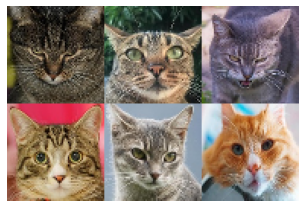

In [6]:
dataset = CatDataset()
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

### Задание 1 (2 балла)
Для начала реализуем генератор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ConvTranspose2D`, `nn.ReLU`, а также функция `F.interpolate`.

#### Методы
* `__init__` - принимает на вход `start_size`, `latent_channels`, `start_channels` и `upsamplings`. Первые два аргумента отвечают за размер случайного шума, из которого в последствии будет сгенерирована картинка. `start_channels` отвечает за то, сколько каналов должно быть в картинке перед тем, как к ней будут применены upsampling блоки. `upsamplings` - это количество upsampling блоков, которые должны быть применены к картинке. В каждом таком локе количество каналов уменьшается в два раза.


* `forward` - принимает на вход `batch_size`, генерирует `batch_size` картинок из случайного шума.

In [ ]:
class Generator(nn.Module):
    def __init__(self, start_size=2, latent_channels=32, start_channels=1024, upsamplings=6):
        super().__init__()
        self.start_size = start_size
        self.latent_channels = latent_channels
        self.start_channels = start_channels
        self.upsamplings = upsamplings

        c = self.start_channels
        in_block = nn.Conv2d(in_channels=self.latent_channels, 
                      out_channels=c, 
                      kernel_size=1,
                      stride=1,
                      padding=0,
                      bias=False)
        
        core_blocks = []

        for i in range(self.upsamplings):
            core_blocks += [
                  nn.ConvTranspose2d(in_channels=c, 
                                out_channels=c // 2, 
                                kernel_size=4,
                                stride=2,
                                padding=1,
                                bias=False),
                  nn.BatchNorm2d(c // 2, affine=False),
                  nn.ReLU()      
            ]
            c //= 2

        out_block = nn.Conv2d(in_channels=c, 
                      out_channels=3, 
                      kernel_size=1,
                      stride=1,
                      padding=0,
                      bias=False)
        
        self.gen_blocks = nn.Sequential(*([in_block] + core_blocks + [out_block] + [nn.Tanh()]))
    
    def forward(self, batch_size: int):
        input = random_noise(batch_size, self.latent_channels, self.start_size)

        return self.gen_blocks(input)

### Задание 2 (2 балла)
Для начала реализуем дискриминатор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/Disc_DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ReLU` и `nn.Sigmoid`.

#### Методы
* `__init__` - принимает на вход `start_channels` и `downsamplings`. `start_channels` определяет количество каналов, которые должны быть в изображении перед применением downsampling блоков.


* `forward` - принимает на вход `x` - тензор с картинками. Возвращает вектор с размерностью `batch_size`.

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, downsamplings=6, start_channels=8):
        super().__init__()
        self.downsamplings = downsamplings
        self.start_channels = start_channels

        c = self.start_channels
        in_block = nn.Conv2d(in_channels=3, 
                      out_channels=c, 
                      kernel_size=1,
                      stride=1,
                      padding=0,
                      bias=False)
      
        core_blocks = []

        for i in range(self.downsamplings):
            core_blocks += [
                nn.Conv2d(in_channels=c, 
                          out_channels=c * 2, 
                          kernel_size=3,
                          stride=2,
                          padding=1,
                          bias=False),
                nn.BatchNorm2d(c * 2, affine=False),
                nn.ReLU()   
            ]
            c *= 2
      

        self.disc_blocks = nn.Sequential(*([in_block] + core_blocks + [nn.Flatten(),
                                                                       nn.Linear(in_features=c * 4, out_features=1),
                                                                       nn.Sigmoid()]))
        
    def forward(self, x):
        return self.disc_blocks(x)

In [ ]:
def train_gan():
    generator = Generator()
    discriminator = Discriminator()
    epochs = 120
    visualise_every = 10
    batch_size = 8
    generator.cuda()
    discriminator.cuda()

    gen_optim = Adam(generator.parameters(), lr=1e-4, betas=(0.5, 0.999))
    disc_optim = Adam(discriminator.parameters(), lr=1e-4, betas=(0.5, 0.999))

    dataset = CatDataset(size=128)

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        gen_loss_avg = 0
        disc_loss_avg = 0

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            # Positive update
            batch = batch.cuda()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Negative update
            batch = generator(batch_size).detach()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.zeros_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Generator update
            batch = generator(batch_size)
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            gen_optim.zero_grad()
            loss.backward()
            gen_optim.step()
            gen_loss_avg += loss.item()
            
        if (ep + 1) % visualise_every == 0:
            with torch.no_grad():
                visualise(generator(6), rows=2)

        print(f"Epoch {ep+1} | Discriminator loss: {disc_loss_avg / total_batches} | Generator loss: {gen_loss_avg / total_batches}")

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 1 | Discriminator loss: 0.23864293998392172 | Generator loss: 4.953872661135211


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 2 | Discriminator loss: 0.19323774844970837 | Generator loss: 5.11721989327336


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 3 | Discriminator loss: 0.054095934121864066 | Generator loss: 6.493761419509509


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 4 | Discriminator loss: 0.00571948092359542 | Generator loss: 6.6989782956075965


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 5 | Discriminator loss: 0.007224393519341096 | Generator loss: 7.990552047765033


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 6 | Discriminator loss: 0.012789571110347347 | Generator loss: 7.856629362757902


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 7 | Discriminator loss: 0.08933500457525895 | Generator loss: 7.0181232964770395


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 8 | Discriminator loss: 0.33583848577133174 | Generator loss: 4.85356412374455


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 9 | Discriminator loss: 0.5490040415027562 | Generator loss: 3.6666413315149566


  0%|          | 0/645 [00:00<?, ?it/s]

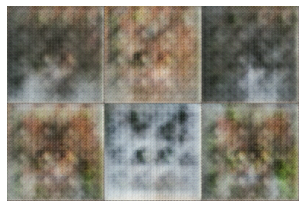

Epoch 10 | Discriminator loss: 0.6664375143269545 | Generator loss: 3.237663433511065


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 11 | Discriminator loss: 0.6958426886233819 | Generator loss: 2.9313832074403763


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 12 | Discriminator loss: 0.7234627906470241 | Generator loss: 2.725534482980552


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 13 | Discriminator loss: 0.7031001879693362 | Generator loss: 2.705760343382077


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 14 | Discriminator loss: 0.7054745495364197 | Generator loss: 2.6544012799859047


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 15 | Discriminator loss: 0.6981801372863821 | Generator loss: 2.5993881158021668


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 16 | Discriminator loss: 0.6782248795908509 | Generator loss: 2.7648658820931216


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 17 | Discriminator loss: 0.6697749930559744 | Generator loss: 2.5660556493708806


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 18 | Discriminator loss: 0.6793371444038023 | Generator loss: 2.674724263017592


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 19 | Discriminator loss: 0.6609869121197143 | Generator loss: 2.6502087593356274


  0%|          | 0/645 [00:00<?, ?it/s]

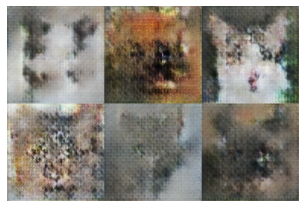

Epoch 20 | Discriminator loss: 0.6574985826787862 | Generator loss: 2.61846119725371


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 21 | Discriminator loss: 0.6614695536599984 | Generator loss: 2.5972296758468105


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 22 | Discriminator loss: 0.6024784245320396 | Generator loss: 2.7252360524042794


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 23 | Discriminator loss: 0.5775574718821456 | Generator loss: 2.7960573786996905


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 24 | Discriminator loss: 0.5588920369957789 | Generator loss: 2.8640861544549834


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 25 | Discriminator loss: 0.5442658429471877 | Generator loss: 2.9342627790958984


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 26 | Discriminator loss: 0.5143436479592993 | Generator loss: 2.9770636867662392


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 27 | Discriminator loss: 0.5120826788117924 | Generator loss: 3.0178828744784645


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 28 | Discriminator loss: 0.4896466225583698 | Generator loss: 3.1041710229578965


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 29 | Discriminator loss: 0.4641319464760911 | Generator loss: 3.157845170879216


  0%|          | 0/645 [00:00<?, ?it/s]

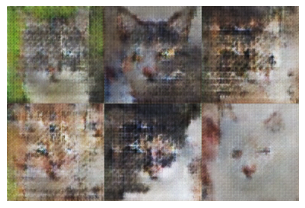

Epoch 30 | Discriminator loss: 0.4405949613260559 | Generator loss: 3.1805043891766425


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 31 | Discriminator loss: 0.4402841406839832 | Generator loss: 3.386327090100472


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 32 | Discriminator loss: 0.3875656621916142 | Generator loss: 3.5631746192526372


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 33 | Discriminator loss: 0.4101621652304365 | Generator loss: 3.516697108190252


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 34 | Discriminator loss: 0.40699942995047 | Generator loss: 3.439673988252693


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 35 | Discriminator loss: 0.3826985541203138 | Generator loss: 3.6935733089350764


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 36 | Discriminator loss: 0.38335201574001576 | Generator loss: 3.613561410942803


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 37 | Discriminator loss: 0.37574685976135286 | Generator loss: 3.687900631231551


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 38 | Discriminator loss: 0.3414011894660548 | Generator loss: 3.7108576537474343


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 39 | Discriminator loss: 0.33534680272917833 | Generator loss: 3.9817007417264194


  0%|          | 0/645 [00:00<?, ?it/s]

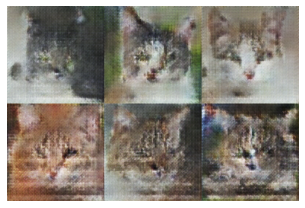

Epoch 40 | Discriminator loss: 0.35704386408994554 | Generator loss: 3.717128345499868


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 41 | Discriminator loss: 0.3385994319586367 | Generator loss: 3.963432385591987


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 42 | Discriminator loss: 0.3447824685953639 | Generator loss: 3.8869801525558745


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 43 | Discriminator loss: 0.30319168181251926 | Generator loss: 3.9596205955336554


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 44 | Discriminator loss: 0.3283362285540799 | Generator loss: 4.066216170139935


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 45 | Discriminator loss: 0.31869472338020505 | Generator loss: 4.0692222571891286


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 46 | Discriminator loss: 0.3173294284725891 | Generator loss: 3.8895833936537274


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 47 | Discriminator loss: 0.2954561074687104 | Generator loss: 4.063842651266489


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 48 | Discriminator loss: 0.33239641020058147 | Generator loss: 4.104815431170582


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 49 | Discriminator loss: 0.32487318464210596 | Generator loss: 4.048553783053197


  0%|          | 0/645 [00:00<?, ?it/s]

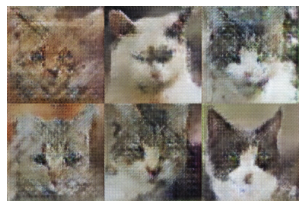

Epoch 50 | Discriminator loss: 0.29969575485821615 | Generator loss: 4.062677116416719


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 51 | Discriminator loss: 0.3164191466985471 | Generator loss: 4.104943062577929


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 52 | Discriminator loss: 0.293392966281351 | Generator loss: 4.161769966161029


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 53 | Discriminator loss: 0.2984191923744491 | Generator loss: 4.223689607211521


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 54 | Discriminator loss: 0.28639769035194346 | Generator loss: 4.307683435563716


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 55 | Discriminator loss: 0.2788218573897375 | Generator loss: 4.290378241527895


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 56 | Discriminator loss: 0.2914526956382196 | Generator loss: 4.335896975505426


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 57 | Discriminator loss: 0.28231575159548156 | Generator loss: 4.2363936703952945


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 58 | Discriminator loss: 0.29763303519575857 | Generator loss: 4.05234412960014


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 59 | Discriminator loss: 0.2735690945750976 | Generator loss: 4.3932615853614685


  0%|          | 0/645 [00:00<?, ?it/s]

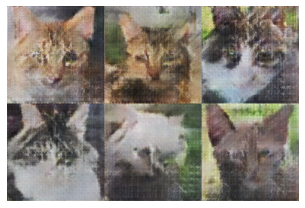

Epoch 60 | Discriminator loss: 0.2816763861336773 | Generator loss: 4.294820499901446


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 61 | Discriminator loss: 0.2621633633225852 | Generator loss: 4.5033581487325405


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 62 | Discriminator loss: 0.27644037422414725 | Generator loss: 4.467681605993591


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 63 | Discriminator loss: 0.26446258280914026 | Generator loss: 4.4478757345806


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 64 | Discriminator loss: 0.2605611035511705 | Generator loss: 4.435114225476795


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 65 | Discriminator loss: 0.2621654018669219 | Generator loss: 4.61110215240754


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 66 | Discriminator loss: 0.2786569807013106 | Generator loss: 4.547419831804607


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 67 | Discriminator loss: 0.26900799833321337 | Generator loss: 4.590470177323922


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 68 | Discriminator loss: 0.24299647529406113 | Generator loss: 4.521827435641555


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 69 | Discriminator loss: 0.23965694122061593 | Generator loss: 4.504061091714394


  0%|          | 0/645 [00:00<?, ?it/s]

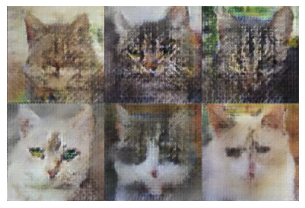

Epoch 70 | Discriminator loss: 0.28747626497528844 | Generator loss: 4.386239424070216


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 71 | Discriminator loss: 0.2585648589157465 | Generator loss: 4.564673313442965


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 72 | Discriminator loss: 0.22540672167554515 | Generator loss: 4.57361285444002


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 73 | Discriminator loss: 0.26154510953221083 | Generator loss: 4.5315982542978315


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 74 | Discriminator loss: 0.2670100601277264 | Generator loss: 4.422138483998198


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 75 | Discriminator loss: 0.2274392547432009 | Generator loss: 4.626708998628285


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 76 | Discriminator loss: 0.22127356220320654 | Generator loss: 4.616012139627652


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 77 | Discriminator loss: 0.21837652943451294 | Generator loss: 4.578295133591439


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 78 | Discriminator loss: 0.21794334313557365 | Generator loss: 4.866103542887646


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 79 | Discriminator loss: 0.23233375919706656 | Generator loss: 4.920863114991543


  0%|          | 0/645 [00:00<?, ?it/s]

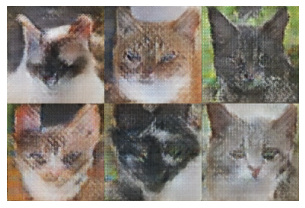

Epoch 80 | Discriminator loss: 0.22235224047317076 | Generator loss: 4.792067299348227


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 81 | Discriminator loss: 0.20104378610861653 | Generator loss: 4.9445361820807365


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 82 | Discriminator loss: 0.22569916680250396 | Generator loss: 4.765369119666378


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 83 | Discriminator loss: 0.23057187961030254 | Generator loss: 4.866661352493008


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 84 | Discriminator loss: 0.18061388166695586 | Generator loss: 5.19459143160663


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 85 | Discriminator loss: 0.21986385017082924 | Generator loss: 4.8392260474679265


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 86 | Discriminator loss: 0.2015547674107626 | Generator loss: 4.923037217455621


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 87 | Discriminator loss: 0.21052150517859744 | Generator loss: 4.888099507561752


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 88 | Discriminator loss: 0.20374771388327734 | Generator loss: 5.027182479915411


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 89 | Discriminator loss: 0.22656934916392613 | Generator loss: 4.939558867064322


  0%|          | 0/645 [00:00<?, ?it/s]

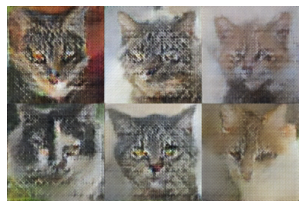

Epoch 90 | Discriminator loss: 0.22101480614441332 | Generator loss: 5.080740091500815


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 91 | Discriminator loss: 0.20735553114766553 | Generator loss: 4.982232953635802


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 92 | Discriminator loss: 0.1804495395759145 | Generator loss: 5.139985398383614


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 93 | Discriminator loss: 0.1900136434630199 | Generator loss: 5.069977361130419


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 94 | Discriminator loss: 0.20394981308785476 | Generator loss: 5.245388672773882


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 95 | Discriminator loss: 0.1851126009858247 | Generator loss: 5.119854746768193


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 96 | Discriminator loss: 0.19858344499356737 | Generator loss: 5.160914249764466


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 97 | Discriminator loss: 0.19104753700355417 | Generator loss: 5.340703241480804


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 98 | Discriminator loss: 0.18987498049324888 | Generator loss: 5.054466913760819


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 99 | Discriminator loss: 0.18626432018658326 | Generator loss: 5.194191351070167


  0%|          | 0/645 [00:00<?, ?it/s]

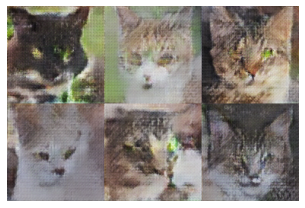

Epoch 100 | Discriminator loss: 0.18993308848551335 | Generator loss: 5.253030780957352


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 101 | Discriminator loss: 0.19438513007445415 | Generator loss: 5.139304772389601


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 102 | Discriminator loss: 0.15981441160225687 | Generator loss: 5.273002110190273


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 103 | Discriminator loss: 0.18404440577498474 | Generator loss: 5.303201270908673


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 104 | Discriminator loss: 0.17070378826809152 | Generator loss: 5.41459007005884


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 105 | Discriminator loss: 0.17226304354862565 | Generator loss: 5.405483229375034


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 106 | Discriminator loss: 0.2163023105188802 | Generator loss: 5.2344034696402755


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 107 | Discriminator loss: 0.18706629843594083 | Generator loss: 5.216496676761912


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 108 | Discriminator loss: 0.14616049061009911 | Generator loss: 5.684940801273962


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 109 | Discriminator loss: 0.18271860920236768 | Generator loss: 5.406664402496


  0%|          | 0/645 [00:00<?, ?it/s]

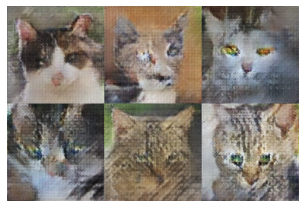

Epoch 110 | Discriminator loss: 0.18494603475944296 | Generator loss: 5.450330016035471


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 111 | Discriminator loss: 0.19196434509520044 | Generator loss: 5.342853912933273


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 112 | Discriminator loss: 0.17484455224489862 | Generator loss: 5.33355787276111


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 113 | Discriminator loss: 0.1638893680367099 | Generator loss: 5.505327408358177


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 114 | Discriminator loss: 0.16038324053844744 | Generator loss: 5.530977889756609


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 115 | Discriminator loss: 0.16002468149738092 | Generator loss: 5.717547357267475


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 116 | Discriminator loss: 0.15216828424102055 | Generator loss: 5.742711972931157


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 117 | Discriminator loss: 0.1662131897597965 | Generator loss: 5.280203932005426


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 118 | Discriminator loss: 0.16081705284914638 | Generator loss: 5.507388569923662


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 119 | Discriminator loss: 0.15478420951918806 | Generator loss: 5.936751361589254


  0%|          | 0/645 [00:00<?, ?it/s]

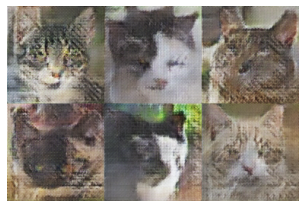

Epoch 120 | Discriminator loss: 0.16746753655126292 | Generator loss: 5.4868189523123805


In [ ]:
train_gan()

### Задание 3 (5 баллов)
Теперь посмотрим на другую модель: Variational Autoencoder. В отличии от GAN, в котором генератор пытается себя обмануть дискриминатор, а дискриминатор старается не быть обманутым, VAE решает задачу реконструкции элемента множества X с применением регуляризации в латентном пространстве. 

Полностью архитектура выглядит так:
![](imgs/VAE.png)

Из нее можно выделить две части: Encoder (по изображению возвращает mu и sigma) и Decoder (по случайному шуму восстанавливает изображение). На высоком уровне VAE можно представить так:

![](imgs/VAE_highlevel.png)

В данном задании вам необходимо реализовать полную архитектуру VAE.

#### Методы
* `__init__` - принимает на вход `img_size`, `downsamplings`, `latent_size`, `linear_hidden_size`, `down_channels` и `up_channels`. `img_size` - размер стороны входного изображения. `downsamplings` - количество downsampling (и upsampling) блоков. `latent_size` - размер латентного пространства, в котором в который будет закодирована картинка. `linear_hidden_size` количество нейронов на скрытом слое полносвязной сети в конце encoder'а. Для полносвязной сети decoder'а это число стоит умножить на 2. `down_channels` - количество каналов, в которое будет преобразовано трехцветное изображение перед применением `downsampling` блоков. `up_channels` - количество каналов, которое должно получиться после применения всех upsampling блоков.

* `forward` - принимает на вход `x`. Считает распределение $N(\mu, \sigma^2)$ и вектор $z \sim N(\mu, \sigma^2)$. Возвращает $x'$ - восстановленную из вектора $z$ картинку и $D_{KL}(N(\mu, \sigma^2), N(0, 1)) = 0.5 \cdot (\sigma^2 + \mu^2 - \log \sigma^2 - 1)$.

* `encode` - принимает на вход `x`. Возвращает вектор из распределения $N(\mu, \sigma^2)$.

* `decode` - принимает на вход `z`. Возвращает восстановленную по вектору картинку.


#### Если хочется улучшить качество
https://arxiv.org/pdf/1906.00446.pdf

In [9]:
class VAELin(nn.Module):
    def __init__(self, img_size=128, downsamplings=5, latent_size=512, linear_hidden_size=1024, down_channels=8, up_channels=16):
        super().__init__()
        
        self.img_size = img_size
        self.downsamplings = downsamplings
        self.latent_size = latent_size
        self.linear_hidden_size = linear_hidden_size
        self.down_channels = down_channels
        self.up_channels = up_channels


        c = self.down_channels
        encoder_in_block = nn.Conv2d(in_channels=3, 
                                      out_channels=c, 
                                      kernel_size=1,
                                      stride=1,
                                      padding=0)
        
        encoder_core_blocks = []
        
        for i in range(self.downsamplings):
            encoder_core_blocks += [
                nn.Conv2d(in_channels=c, 
                          out_channels=c * 2, 
                          kernel_size=3,
                          stride=2,
                          padding=1,
                          bias = False),
                nn.BatchNorm2d(c * 2),
                nn.ReLU(True)   
            ]
            c *= 2
        pic_size =  self.img_size//(2 ** self.downsamplings)
        encoder_out_block = [nn.Conv2d(in_channels=c, 
                                      out_channels=2 * self.latent_size, 
                                      kernel_size=1,
                                      stride=1,
                                      padding=0,
                                      bias = False),
                             nn.Flatten(),
                             nn.Linear(self.latent_size * 2 * pic_size**2 , self.linear_hidden_size)]

        
        self.encoder = nn.Sequential(*([encoder_in_block]+encoder_core_blocks+
                                       encoder_out_block))



        c = self.up_channels * 2 ** self.downsamplings

        decoder_in_block = [nn.Linear(self.latent_size,2*self.linear_hidden_size),
                            nn.Linear(2*self.linear_hidden_size,self.latent_size*pic_size*pic_size),
                            nn.Unflatten(dim=1, unflattened_size=(self.latent_size, pic_size, pic_size)),
                            nn.Conv2d(in_channels=self.latent_size,
                                     out_channels=c, 
                                     kernel_size=1,
                                     stride=1,
                                     padding=0,
                                     bias = False)]
            
        decoder_core_blocks = []

        for j in range(self.downsamplings):
            decoder_core_blocks += [
                  nn.ConvTranspose2d(in_channels=c, 
                                    out_channels=c // 2, 
                                    kernel_size=4,
                                    stride=2,
                                    padding=1,
                                    bias = False),
                  nn.BatchNorm2d(c // 2),
                  nn.ReLU(True),     
            ]
            c //= 2

        decoder_out_block = nn.Conv2d(in_channels=self.up_channels, 
                                      out_channels=3, 
                                      kernel_size=1,
                                      stride=1,
                                      padding=0,
                                      bias = False)

        self.decoder = nn.Sequential(*(decoder_in_block+decoder_core_blocks+
                                       [decoder_out_block]+[nn.Tanh()]))
        self.mu_fc = nn.Linear(self.linear_hidden_size, self.latent_size)
        self.sigma_fc = nn.Linear(self.linear_hidden_size, self.latent_size)

    def forward(self, x):
        input = self.encoder(x)

        mu = self.mu_fc(input)
        sigma = torch.exp(self.sigma_fc(input))

        eps = torch.distributions.Normal(0, 1).sample(mu.shape).cuda()
        z = eps * sigma + mu

        x_pred = self.decode(z)
        kld = 0.5 * (sigma ** 2 + mu ** 2 - torch.log(sigma ** 2) - 1)

        return x_pred, kld


    
    def encode(self, x):
        input = self.encoder(x)
        mu = self.mu_fc(input)
        sigma = torch.exp(self.sigma_fc(input))
        
        eps = torch.distributions.Normal(0, 1).sample(mu.shape).cuda()
        z = eps * sigma + mu

        return z
    
    def decode(self, z):
        return self.decoder(z)

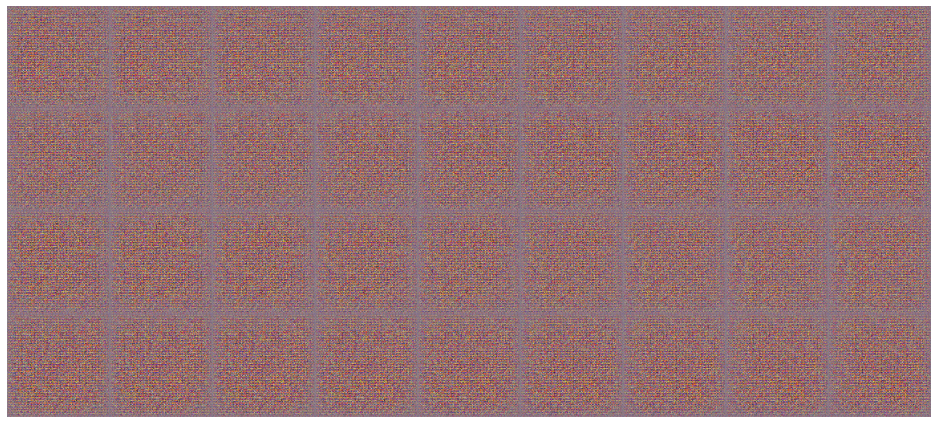

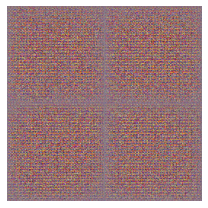

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 7744.479906923282 | KLD loss: 655.4669228162825


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 5052.802106963922 | KLD loss: 770.6347739652077


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 4450.128251164596 | KLD loss: 847.5052237184892


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 4196.171055385044 | KLD loss: 914.7953918646581


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 3973.999699373423 | KLD loss: 955.5939689304518


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 3725.743105681046 | KLD loss: 976.5097747234084


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 3515.518128199607 | KLD loss: 978.1732625072788


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 3388.432380628882 | KLD loss: 985.7458518839771


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 3242.8796178213556 | KLD loss: 981.9492319237371


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 3130.1300697089723 | KLD loss: 992.5412090609533


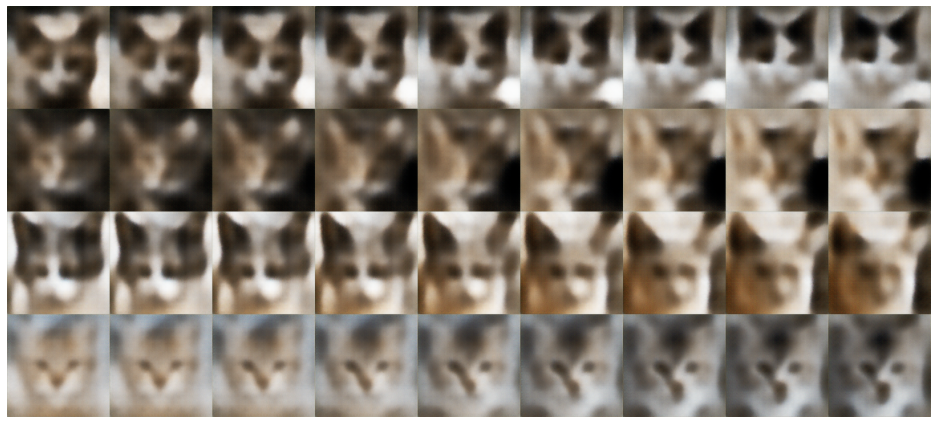

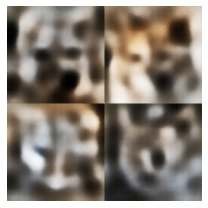

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 3075.869763486874 | KLD loss: 1015.0128241118437


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 2998.3952782672386 | KLD loss: 1015.4945764956267


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 2942.7666982330893 | KLD loss: 1010.8984831815922


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 2877.962101717173 | KLD loss: 1003.6530562691066


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 2846.723876763575 | KLD loss: 1015.6040210605408


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 2820.03988723281 | KLD loss: 1025.8316657024882


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 2739.408559289778 | KLD loss: 1007.7093166564563


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 2732.5384944181264 | KLD loss: 1020.2976319686226


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 2699.5546857940485 | KLD loss: 1028.9723094679555


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 2652.066484723772 | KLD loss: 1022.9647972154321


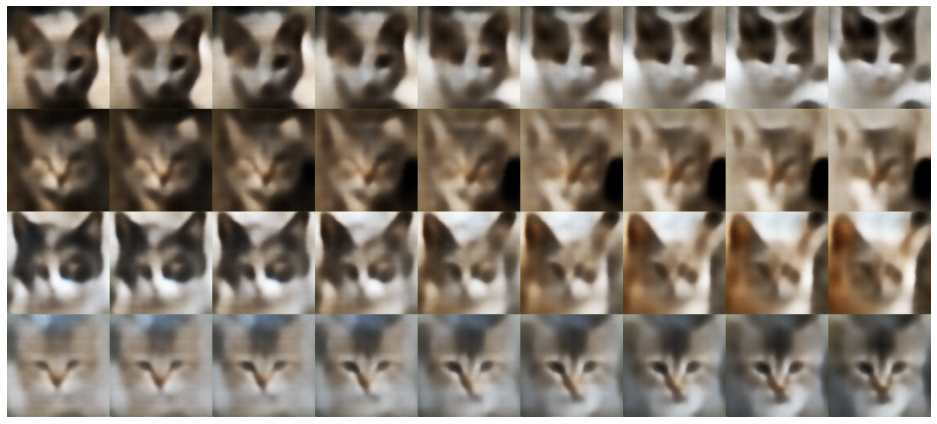

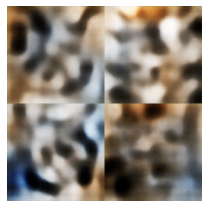

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 2627.762534953052 | KLD loss: 1014.2378192214492


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 2620.005043361498 | KLD loss: 1025.533455890158


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 2576.4310770923307 | KLD loss: 1015.1505339249321


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 2551.0211206282147 | KLD loss: 1013.849688512198


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 2524.372412450565 | KLD loss: 1016.2319783275913


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 2524.6668452861145 | KLD loss: 1021.6325576497901


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 2486.130833596176 | KLD loss: 1016.2764965554942


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 2477.6592528538677 | KLD loss: 1015.8974997952859


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 2464.1348628642395 | KLD loss: 1019.2148564498617


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 2441.006319223724 | KLD loss: 1017.0363298499066


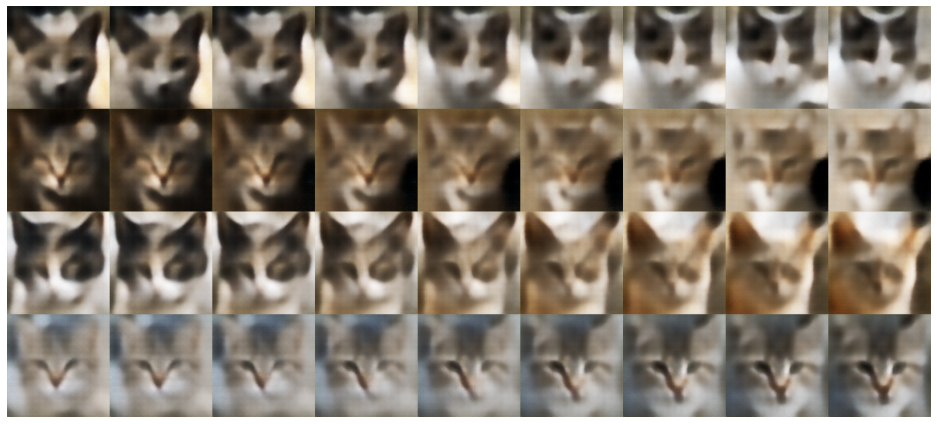

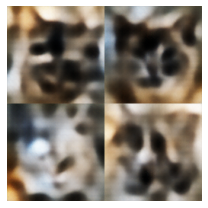

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 2400.8977987159114 | KLD loss: 1008.3225085335489


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 2404.4803768181655 | KLD loss: 1010.5980148789305


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 2392.1640793699657 | KLD loss: 1011.7071878184443


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 2377.3155964916537 | KLD loss: 1014.4702533224355


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 2354.450279093677 | KLD loss: 1011.6426069366265


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 2353.418816418381 | KLD loss: 1008.9908378079812


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 2332.7329429484303 | KLD loss: 1007.0660638276095


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 2332.8031068410933 | KLD loss: 1015.8908546400367


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 2306.5752607073105 | KLD loss: 1005.4509346529563


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 2302.1429471791903 | KLD loss: 1008.3532907237177


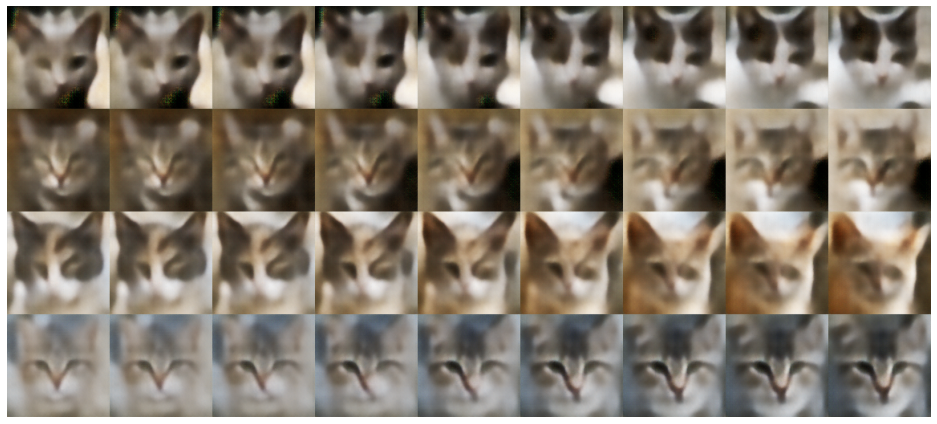

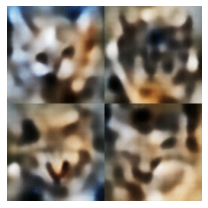

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 2278.106283626201 | KLD loss: 1002.6546053679093


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 2270.1071652240635 | KLD loss: 1002.4197895689781


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 2269.156686154952 | KLD loss: 1008.6064890038152


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 2259.8301177409867 | KLD loss: 1004.5046264458888


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 2244.9858263856877 | KLD loss: 999.6925430771727


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 2240.8029157745173 | KLD loss: 999.0661950911054


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 2234.097524702179 | KLD loss: 1001.936470268676


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 2204.22909109933 | KLD loss: 996.4140903638756


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 2212.6134004770597 | KLD loss: 1000.536695966069


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 2194.067438161151 | KLD loss: 994.1093260012799


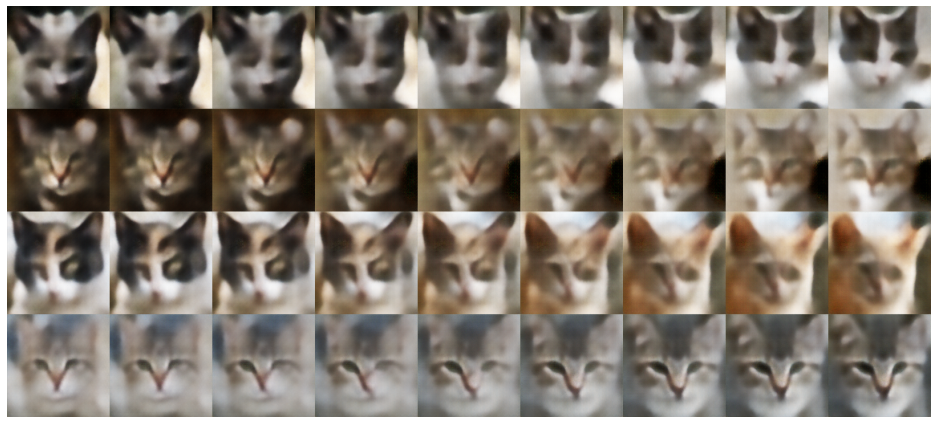

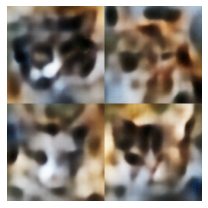

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 51 | Reconstruction loss: 2197.5993470375583 | KLD loss: 998.0895333615889


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 52 | Reconstruction loss: 2169.938228062221 | KLD loss: 989.9729509057465


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 53 | Reconstruction loss: 2194.918341974294 | KLD loss: 1001.8936004638672


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 54 | Reconstruction loss: 2164.806478938701 | KLD loss: 993.0403151423294


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 55 | Reconstruction loss: 2157.816533059067 | KLD loss: 990.8763725328149


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 56 | Reconstruction loss: 2138.4805428641184 | KLD loss: 989.8989313729802


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 57 | Reconstruction loss: 2156.668896408555 | KLD loss: 994.0401929772419


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 58 | Reconstruction loss: 2138.820277812318 | KLD loss: 992.4232557782475


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 59 | Reconstruction loss: 2118.513871281784 | KLD loss: 986.903961560741


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 60 | Reconstruction loss: 2130.758869431774 | KLD loss: 988.5975017666076


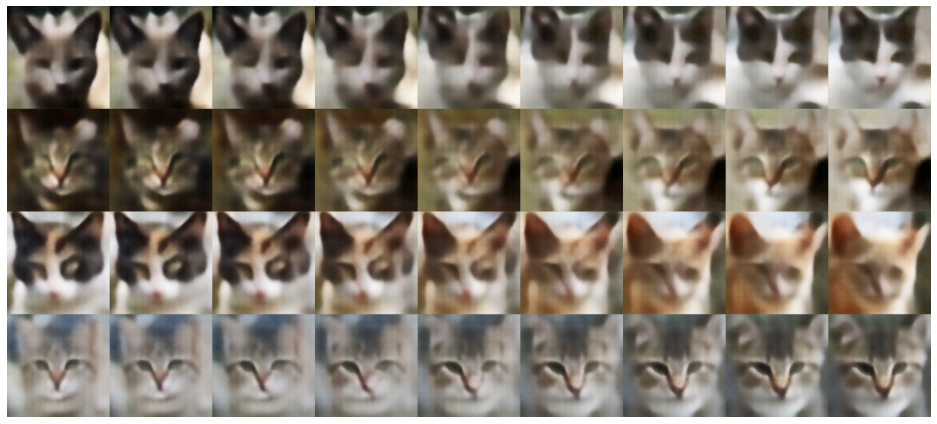

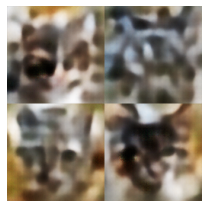

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 61 | Reconstruction loss: 2106.051707202603 | KLD loss: 988.1610380374127


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 62 | Reconstruction loss: 2113.3376262025063 | KLD loss: 988.266879348281


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 63 | Reconstruction loss: 2094.0146152662196 | KLD loss: 985.200713921778


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 64 | Reconstruction loss: 2102.0689828055247 | KLD loss: 986.9491692774044


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 65 | Reconstruction loss: 2074.3908117069222 | KLD loss: 984.729022292617


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 66 | Reconstruction loss: 2071.603703090123 | KLD loss: 981.0893047640783


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 67 | Reconstruction loss: 2065.691303134705 | KLD loss: 980.4073002027428


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 68 | Reconstruction loss: 2059.8913418787606 | KLD loss: 980.4695849685195


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 69 | Reconstruction loss: 2054.5999194790857 | KLD loss: 979.023803142287


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 70 | Reconstruction loss: 2048.3570554745124 | KLD loss: 980.8378560320931


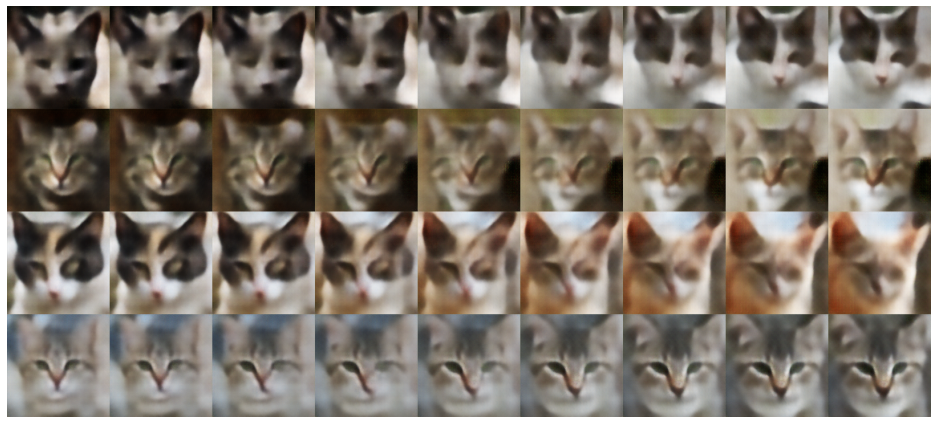

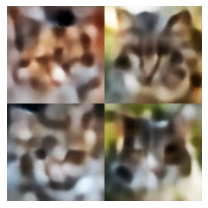

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 71 | Reconstruction loss: 2037.4125188033772 | KLD loss: 976.2504028888962


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 72 | Reconstruction loss: 2034.4950495180876 | KLD loss: 976.5916596406735


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 73 | Reconstruction loss: 2030.155158380544 | KLD loss: 976.2948275737881


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 74 | Reconstruction loss: 2018.6364086459141 | KLD loss: 975.0591799339152


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 75 | Reconstruction loss: 2026.4431188358283 | KLD loss: 975.3556818991715


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 76 | Reconstruction loss: 2011.0129976450287 | KLD loss: 972.306692656523


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 77 | Reconstruction loss: 2008.5035326466057 | KLD loss: 972.7487760745221


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 78 | Reconstruction loss: 2012.2511549292144 | KLD loss: 975.2033323678911


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 79 | Reconstruction loss: 1996.1994170194828 | KLD loss: 970.4321431225131


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 80 | Reconstruction loss: 1997.5254319469382 | KLD loss: 971.2204727267626


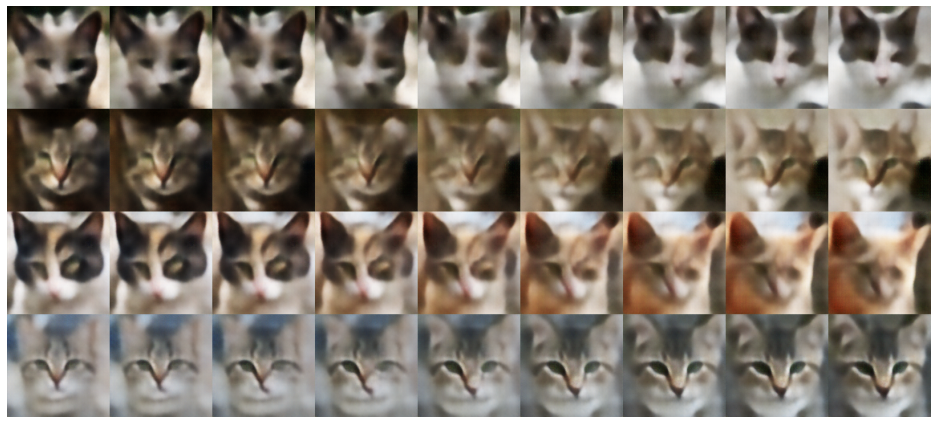

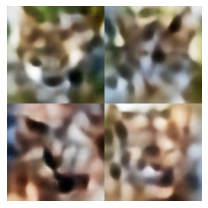

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 81 | Reconstruction loss: 1990.0012538744056 | KLD loss: 970.6325199293053


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 82 | Reconstruction loss: 1990.1871497112772 | KLD loss: 970.8898107872246


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 83 | Reconstruction loss: 1977.5788883185535 | KLD loss: 966.8192595487797


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 84 | Reconstruction loss: 1968.1046332128299 | KLD loss: 965.4084821428571


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 85 | Reconstruction loss: 1968.5822035511087 | KLD loss: 966.7544702565448


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 86 | Reconstruction loss: 1964.51656914942 | KLD loss: 968.2741777882072


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 87 | Reconstruction loss: 1966.3183368185291 | KLD loss: 965.7588874390407


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 88 | Reconstruction loss: 1956.035285523219 | KLD loss: 967.549600731512


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 89 | Reconstruction loss: 1947.2878772427578 | KLD loss: 961.6871313249102


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 90 | Reconstruction loss: 1942.1402650442183 | KLD loss: 965.1267974095315


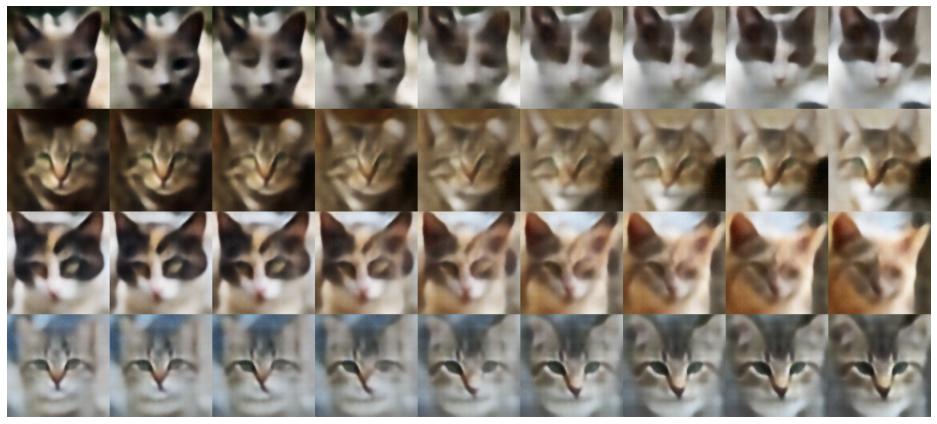

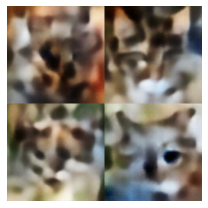

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 91 | Reconstruction loss: 1934.5679152589407 | KLD loss: 960.7710159017432


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 92 | Reconstruction loss: 1938.349423805379 | KLD loss: 958.8463552723761


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 93 | Reconstruction loss: 1933.3385200263551 | KLD loss: 961.4566678823152


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 94 | Reconstruction loss: 1921.7177015979837 | KLD loss: 960.2947699505349


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 95 | Reconstruction loss: 1927.2906340604984 | KLD loss: 957.4006154315072


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 96 | Reconstruction loss: 1917.3421410981173 | KLD loss: 959.5417304187088


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 97 | Reconstruction loss: 1914.151567731585 | KLD loss: 959.3626146020356


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 98 | Reconstruction loss: 1918.8517757439465 | KLD loss: 957.3240153626625


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 99 | Reconstruction loss: 1904.8544992008565 | KLD loss: 959.6885672622586


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 100 | Reconstruction loss: 1904.4094623068104 | KLD loss: 955.8083735874721


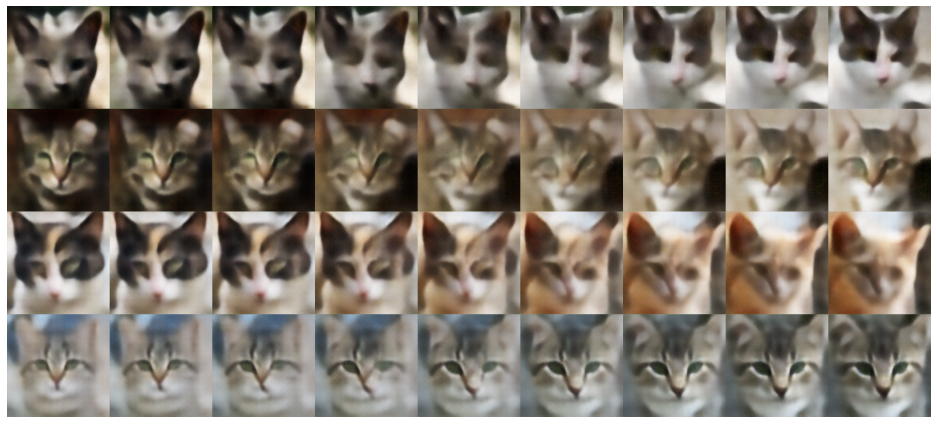

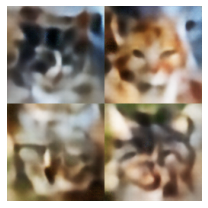

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 101 | Reconstruction loss: 1902.6276205311651 | KLD loss: 955.7959402333136


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 102 | Reconstruction loss: 1897.0195448976126 | KLD loss: 953.9818188211192


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 103 | Reconstruction loss: 1894.0712014903193 | KLD loss: 953.3126383716275


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 104 | Reconstruction loss: 1900.6734956539935 | KLD loss: 954.471284759711


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 105 | Reconstruction loss: 1892.9101295234254 | KLD loss: 955.8049948556082


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 106 | Reconstruction loss: 1884.8031153708512 | KLD loss: 953.1868968513442


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 107 | Reconstruction loss: 1876.322226388114 | KLD loss: 949.7318527506005


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 108 | Reconstruction loss: 1878.4101494261938 | KLD loss: 951.6166548640091


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 109 | Reconstruction loss: 1881.4788003293625 | KLD loss: 952.4191077569997


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 110 | Reconstruction loss: 1859.3530631687331 | KLD loss: 947.4197441717113


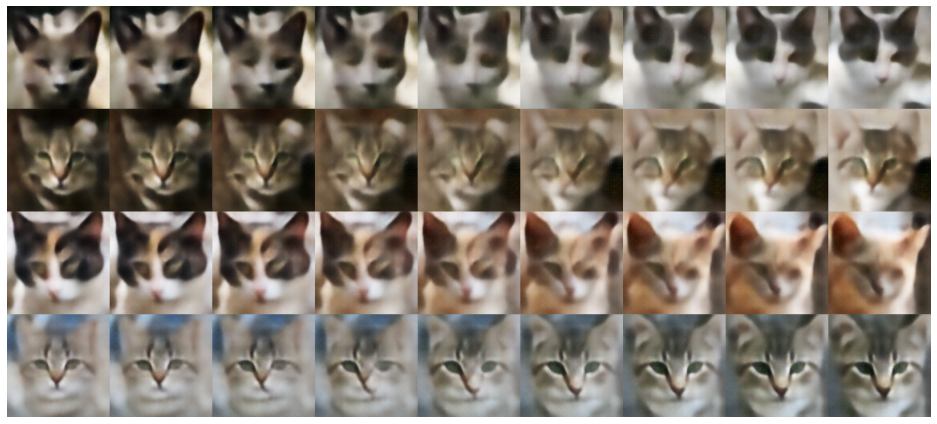

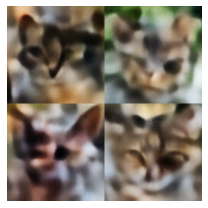

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 111 | Reconstruction loss: 1868.190705293454 | KLD loss: 946.8734330834809


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 112 | Reconstruction loss: 1872.9020827394095 | KLD loss: 949.2881769215838


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 113 | Reconstruction loss: 1867.539631150524 | KLD loss: 952.7578850977169


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 114 | Reconstruction loss: 1856.85515409671 | KLD loss: 947.1383943735442


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 115 | Reconstruction loss: 1856.2717554317499 | KLD loss: 947.931866379258


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 116 | Reconstruction loss: 1849.8239759362261 | KLD loss: 944.0021995402271


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 117 | Reconstruction loss: 1849.8301945088072 | KLD loss: 946.1764441069608


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 118 | Reconstruction loss: 1838.6715087890625 | KLD loss: 941.1462455417799


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 119 | Reconstruction loss: 1840.8246319693808 | KLD loss: 941.764971715323


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 120 | Reconstruction loss: 1845.6447827830818 | KLD loss: 943.3888602878736


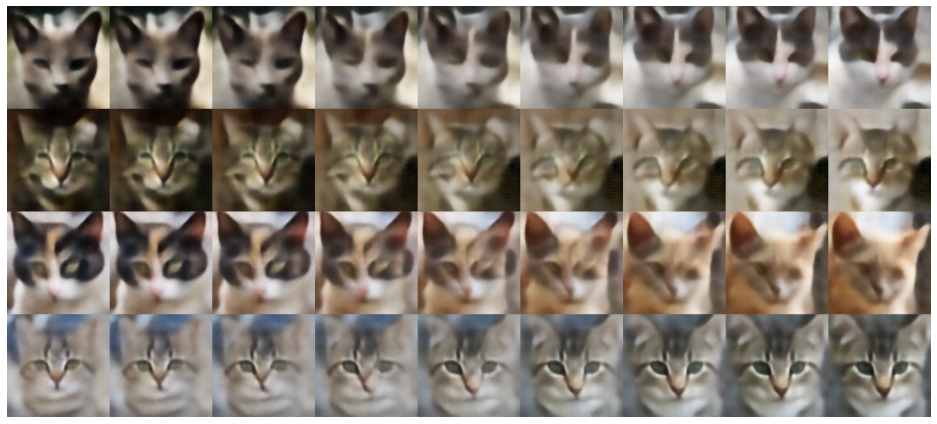

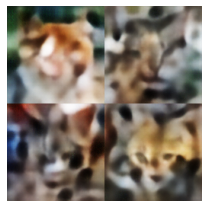

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 121 | Reconstruction loss: 1836.509224080151 | KLD loss: 944.7103120791986


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 122 | Reconstruction loss: 1830.5133709640977 | KLD loss: 939.3963149171439


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 123 | Reconstruction loss: 1839.7685453995414 | KLD loss: 942.2445836985333


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 124 | Reconstruction loss: 1829.0996622594987 | KLD loss: 939.8141318374539


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 125 | Reconstruction loss: 1828.0016257718482 | KLD loss: 940.2298166026239


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 126 | Reconstruction loss: 1825.21814230214 | KLD loss: 939.390350531347


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 127 | Reconstruction loss: 1828.4020846349113 | KLD loss: 939.9737829362383


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 128 | Reconstruction loss: 1819.573515518852 | KLD loss: 940.6384513333718


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 129 | Reconstruction loss: 1816.5355560113185 | KLD loss: 940.5172324802564


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 130 | Reconstruction loss: 1813.3553205217634 | KLD loss: 940.4330929584385


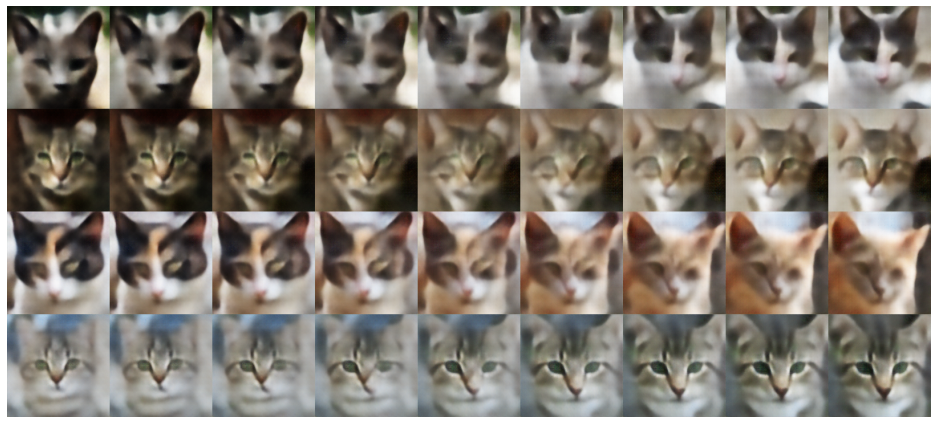

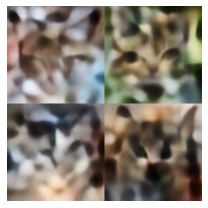

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 131 | Reconstruction loss: 1810.0940828501068 | KLD loss: 936.5924429567705


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 132 | Reconstruction loss: 1811.3485528223264 | KLD loss: 937.771391021539


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 133 | Reconstruction loss: 1805.214261072763 | KLD loss: 937.4103056155377


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 134 | Reconstruction loss: 1801.055945165409 | KLD loss: 934.4067861426691


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 135 | Reconstruction loss: 1802.2621456169934 | KLD loss: 936.6242003825881


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 136 | Reconstruction loss: 1794.3546220293697 | KLD loss: 931.867470687961


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 137 | Reconstruction loss: 1801.3136346473457 | KLD loss: 931.3922570270041


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 138 | Reconstruction loss: 1791.7828270574535 | KLD loss: 933.1371624869589


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 139 | Reconstruction loss: 1797.626257665409 | KLD loss: 931.1231329307793


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 140 | Reconstruction loss: 1787.9353148655862 | KLD loss: 932.4483385737639


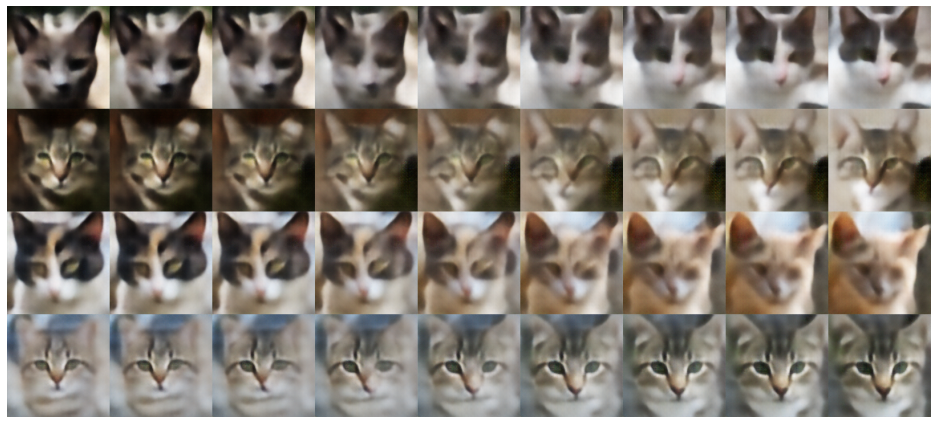

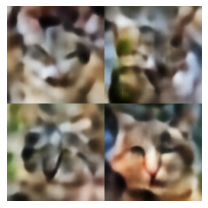

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 141 | Reconstruction loss: 1788.6311330854523 | KLD loss: 931.8316290245293


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 142 | Reconstruction loss: 1788.4497075999004 | KLD loss: 930.4700659520878


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 143 | Reconstruction loss: 1786.9880998504827 | KLD loss: 931.7484762061457


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 144 | Reconstruction loss: 1783.3674810184455 | KLD loss: 931.4319028676667


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 145 | Reconstruction loss: 1777.8287247367527 | KLD loss: 928.9347466889376


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 146 | Reconstruction loss: 1777.641358559176 | KLD loss: 930.0013432473129


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 147 | Reconstruction loss: 1773.360002126753 | KLD loss: 929.521546168357


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 148 | Reconstruction loss: 1765.2414816151495 | KLD loss: 927.1878913263356


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 149 | Reconstruction loss: 1770.8122340611048 | KLD loss: 926.8255209597002


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 150 | Reconstruction loss: 1762.2084682298744 | KLD loss: 928.3233807486777


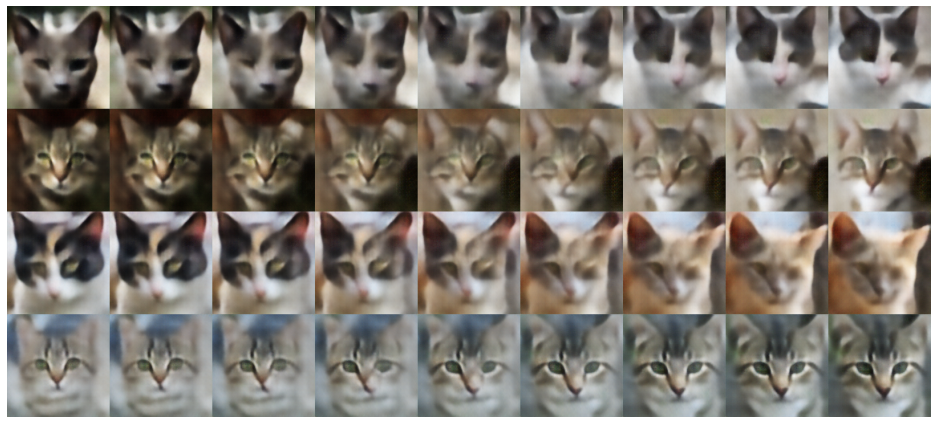

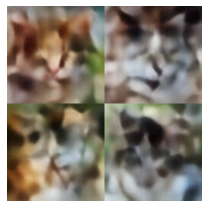

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 151 | Reconstruction loss: 1771.06412226517 | KLD loss: 928.2524621619941


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 152 | Reconstruction loss: 1763.8363916622186 | KLD loss: 927.0698235553244


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 153 | Reconstruction loss: 1765.2983741523317 | KLD loss: 927.5029963143865


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 154 | Reconstruction loss: 1756.0955135748254 | KLD loss: 926.7866227997016


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 155 | Reconstruction loss: 1756.906492908549 | KLD loss: 923.7994070112335


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 156 | Reconstruction loss: 1768.4151524135045 | KLD loss: 927.2758555915785


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 157 | Reconstruction loss: 1753.2307847301413 | KLD loss: 926.670081381472


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 158 | Reconstruction loss: 1751.1051992096516 | KLD loss: 926.5456435872901


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 159 | Reconstruction loss: 1747.3622447896448 | KLD loss: 924.0764739232034


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 160 | Reconstruction loss: 1750.910023943978 | KLD loss: 924.8058719990416


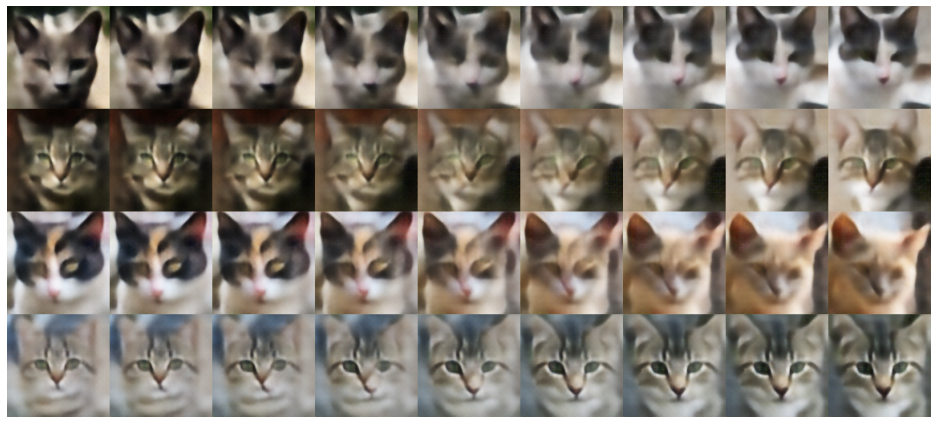

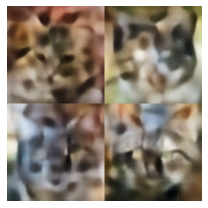

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 161 | Reconstruction loss: 1743.8677177666136 | KLD loss: 923.8990955234315


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 162 | Reconstruction loss: 1748.3905654812452 | KLD loss: 925.0417154442449


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 163 | Reconstruction loss: 1740.2798995497803 | KLD loss: 924.0555136544364


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 164 | Reconstruction loss: 1736.2667077105978 | KLD loss: 921.7563094618898


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 165 | Reconstruction loss: 1735.3382870691903 | KLD loss: 921.4247304786066


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 166 | Reconstruction loss: 1742.6486234487213 | KLD loss: 921.8661238391948


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 167 | Reconstruction loss: 1733.2641866932745 | KLD loss: 923.2112166126323


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 168 | Reconstruction loss: 1731.3109687189137 | KLD loss: 921.1164921351841


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 169 | Reconstruction loss: 1730.1679824923876 | KLD loss: 918.4694450804906


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 170 | Reconstruction loss: 1731.7629612513952 | KLD loss: 918.9028903179287


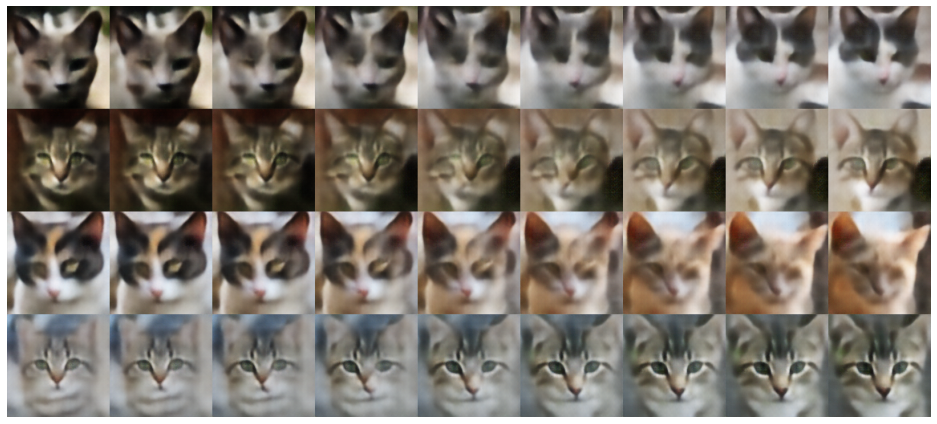

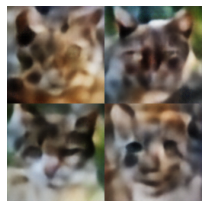

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 171 | Reconstruction loss: 1727.7540760869565 | KLD loss: 918.5094549522637


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 172 | Reconstruction loss: 1724.8380358204338 | KLD loss: 919.2377977075043


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 173 | Reconstruction loss: 1732.4912964246287 | KLD loss: 919.9196195424714


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 174 | Reconstruction loss: 1723.2934687833608 | KLD loss: 918.2674662903969


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 175 | Reconstruction loss: 1720.8209618041235 | KLD loss: 917.5412920839298


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 176 | Reconstruction loss: 1719.339150375461 | KLD loss: 914.8449729777271


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 177 | Reconstruction loss: 1712.3232548873616 | KLD loss: 916.0874510581449


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 178 | Reconstruction loss: 1715.1054182348785 | KLD loss: 915.9917201640443


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 179 | Reconstruction loss: 1715.3349617904757 | KLD loss: 917.0684068573188


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 180 | Reconstruction loss: 1708.630487193232 | KLD loss: 914.570300558339


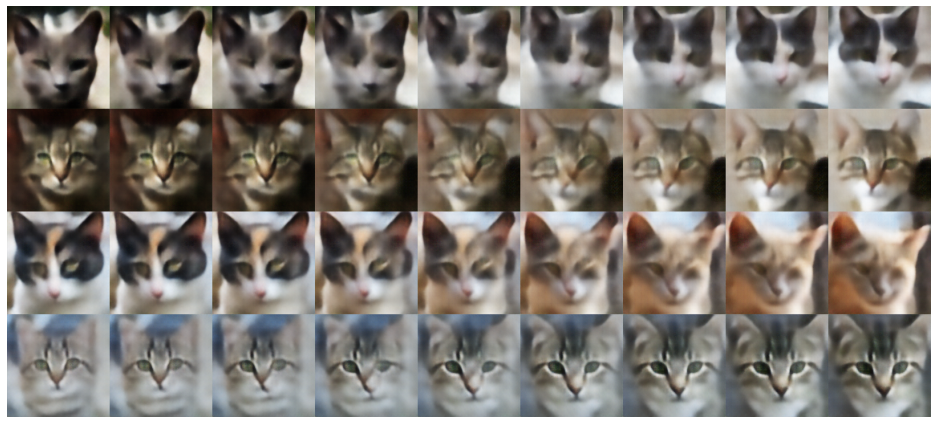

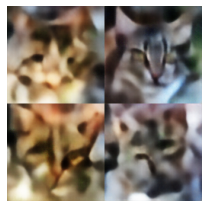

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 181 | Reconstruction loss: 1711.5174986087018 | KLD loss: 919.1183502955466


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 182 | Reconstruction loss: 1709.7402312474221 | KLD loss: 915.1564131079253


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 183 | Reconstruction loss: 1706.9420339454034 | KLD loss: 914.7300034043211


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 184 | Reconstruction loss: 1712.4165719547627 | KLD loss: 915.9257521540482


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 185 | Reconstruction loss: 1702.5116635908992 | KLD loss: 914.6287067484411


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 186 | Reconstruction loss: 1699.9758545300974 | KLD loss: 914.6854705810547


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 187 | Reconstruction loss: 1705.0735205419314 | KLD loss: 913.2989220471115


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 188 | Reconstruction loss: 1695.169467144131 | KLD loss: 912.6472980191248


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 189 | Reconstruction loss: 1703.4761625491315 | KLD loss: 914.1351142077713


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 190 | Reconstruction loss: 1696.3429813740415 | KLD loss: 913.2426921773401


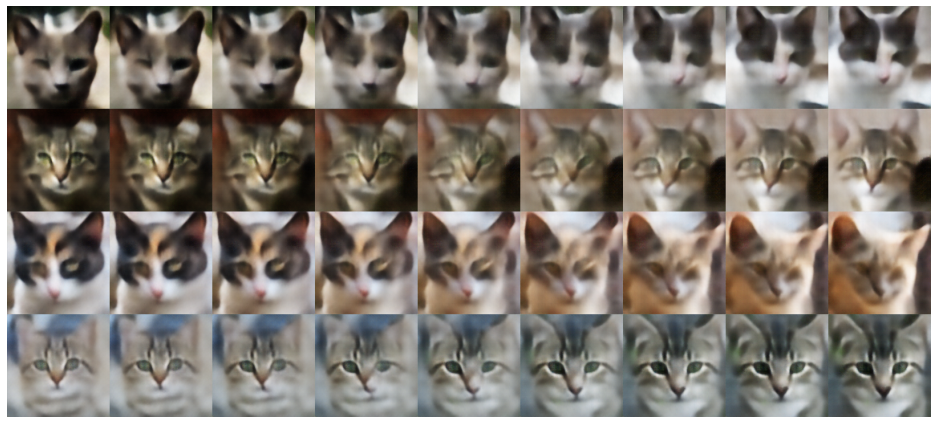

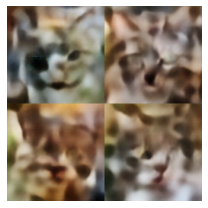

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 191 | Reconstruction loss: 1695.1788971705466 | KLD loss: 914.0932372667775


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 192 | Reconstruction loss: 1694.0309896528352 | KLD loss: 912.9017145381952


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 193 | Reconstruction loss: 1692.8434573345303 | KLD loss: 912.5584140564343


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 194 | Reconstruction loss: 1691.5852142713084 | KLD loss: 910.4168607344538


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 195 | Reconstruction loss: 1687.069848102072 | KLD loss: 911.6561318154661


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 196 | Reconstruction loss: 1688.4559523304056 | KLD loss: 910.7040007218071


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 197 | Reconstruction loss: 1688.632272187227 | KLD loss: 912.4070759648862


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 198 | Reconstruction loss: 1693.1895097057272 | KLD loss: 910.3999439500134


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 199 | Reconstruction loss: 1680.4879327620038 | KLD loss: 910.526954224391


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 200 | Reconstruction loss: 1681.236412759153 | KLD loss: 909.6752504147357


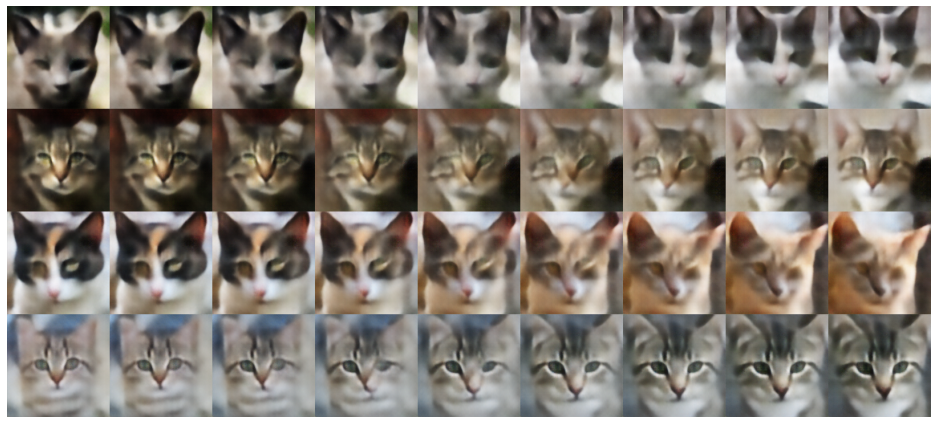

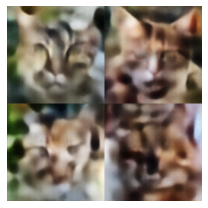

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 201 | Reconstruction loss: 1685.9012255935195 | KLD loss: 911.2206698589443


In [11]:
def train_vae():
    vae = VAELin()
    vae.cuda()

    epochs = 201
    batch_size = 8
    vae_optim = Adam(vae.parameters(), lr=1e-4)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0

        if ep % 10 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.cuda())
                z_2 = vae.encode(test_imgs_2.cuda())
                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)
                visualise(x_int, rows=len(test_imgs_1))
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)
                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.cuda()
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.1 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")

train_vae()